In [ ]:
# numpy bool 오류 발생으로 downgrade 해줌
!pip install numpy==1.23.5

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Mask_RCNN 설치
%cd /content/drive/MyDrive/CV_modules
!git clone https://github.com/alsombra/Mask_RCNN-TF2

%cd Mask_RCNN-TF2

!ls

/content/drive/MyDrive/CV_modules
fatal: destination path 'Mask_RCNN-TF2' already exists and is not an empty directory.
/content/drive/MyDrive/CV_modules/Mask_RCNN-TF2
assets	dist	LICENSE      mask_rcnn_coco.h5	 mrcnn	    requirements.txt  setup.cfg
build	images	MANIFEST.in  mask_rcnn.egg-info  README.md  samples	      setup.py


In [ ]:
import cv2
import sys
from mrcnn import utils
from mrcnn import visualize
import mrcnn.model as modellib
import matplotlib.pyplot as plt
import os

In [ ]:
video_root = '/content/drive/MyDrive/'
video_name = 'street.mp4'
capture = cv2.VideoCapture(video_root +video_name )
connected, frame = capture.read()
connected

True

In [ ]:
frame.shape

(720, 1280, 3)

In [ ]:
save_video = cv2.VideoWriter(video_root + 'street_seg_result.avi',
                             cv2.VideoWriter_fourcc(*'XVID'),
                             24,
                            (frame.shape[1], frame.shape[0])
                            )

In [ ]:
root_dir = '/content/drive/MyDrive/CV_modules/Mask_RCNN-TF2'

In [ ]:
sys.path.append(root_dir)
sys.path

['/content',
 '/env/python',
 '/usr/lib/python310.zip',
 '/usr/lib/python3.10',
 '/usr/lib/python3.10/lib-dynload',
 '',
 '/usr/local/lib/python3.10/dist-packages',
 '/usr/lib/python3/dist-packages',
 '/usr/local/lib/python3.10/dist-packages/IPython/extensions',
 '/root/.ipython',
 '/content/drive/MyDrive/CV_modules',
 '/content/drive/MyDrive/CV_modules/Mask_RCNN-TF2']

In [ ]:
class_names = ['BG', 'person', 'bicycle', 'car', 'motorcycle', 'airplane',
               'bus', 'train', 'truck', 'boat', 'traffic light',
               'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird',
               'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear',
               'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie',
               'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
               'kite', 'baseball bat', 'baseball glove', 'skateboard',
               'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup',
               'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple',
               'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
               'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed',
               'dining table', 'toilet', 'tv', 'laptop', 'mouse', 'remote',
               'keyboard', 'cell phone', 'microwave', 'oven', 'toaster',
               'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors',
               'teddy bear', 'hair drier', 'toothbrush']

In [ ]:
MODEL_DIR = os.path.join(root_dir, 'logs')
IMAGE_DIR = os.path.join(root_dir, 'images')
MODEL_DIR, IMAGE_DIR

('/content/drive/MyDrive/CV_modules/Mask_RCNN-TF2/logs',
 '/content/drive/MyDrive/CV_modules/Mask_RCNN-TF2/images')

In [ ]:
sys.path.append(os.path.join(root_dir, 'samples/coco/'))
sys.path

import coco

In [ ]:
from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession
config = ConfigProto()
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)

COCO_MODEL_PATH = os.path.join(root_dir, 'mask_rcnn_coco.h5')
class InferenceConfig(coco.CocoConfig):
  GPU_COUNT = 1
  IMAGES_PER_GPU = 1

config = InferenceConfig()

In [ ]:
network = modellib.MaskRCNN(mode='inference', model_dir=MODEL_DIR, config=config)
network.load_weights(COCO_MODEL_PATH, by_name=True)

In [ ]:
%cd /content/drive/MyDrive/CV_modules
!git clone https://github.com/markjay4k/Mask-RCNN-series

%cd Mask-RCNN-series

!ls

/content/drive/MyDrive/CV_modules
fatal: destination path 'Mask-RCNN-series' already exists and is not an empty directory.
/content/drive/MyDrive/CV_modules/Mask-RCNN-series
'Mask_RCNN Install Instructions.ipynb'	 README.md	    visualize_cv2.py
 process_video.py			 requirements.txt   visualize_cv.py


In [ ]:
!cp /content/drive/MyDrive/CV_modules/Mask-RCNN-series/visualize_cv.py /content/drive/MyDrive/CV_modules/Mask_RCNN-TF2/mrcnn

In [ ]:
from mrcnn import visualize_cv
import mrcnn.model as modellib

In [ ]:
colors = visualize_cv.random_colors(len(class_names))
len(colors)

81

In [ ]:
def show(img):
  fig = plt.gcf()
  fig.set_size_inches(16,10)
  plt.axis('off')
  plt.imshow(img)
  plt.show()

In [ ]:
frame_show = 20
current_frame = 0

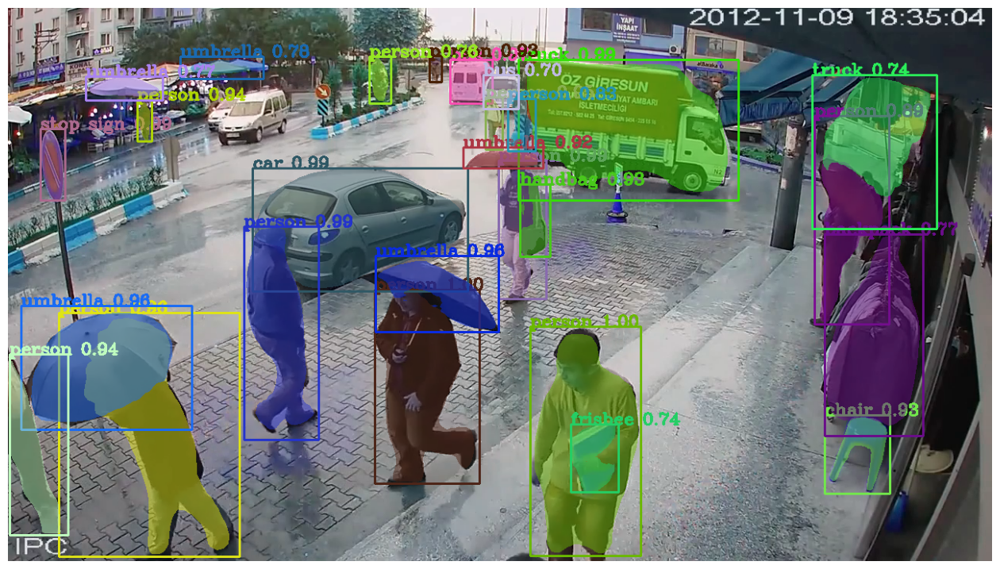

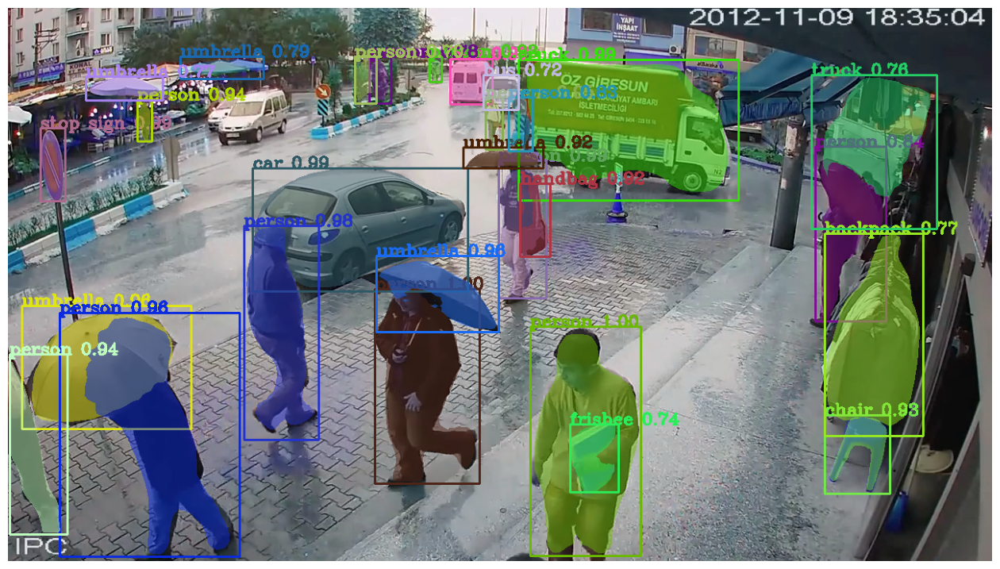

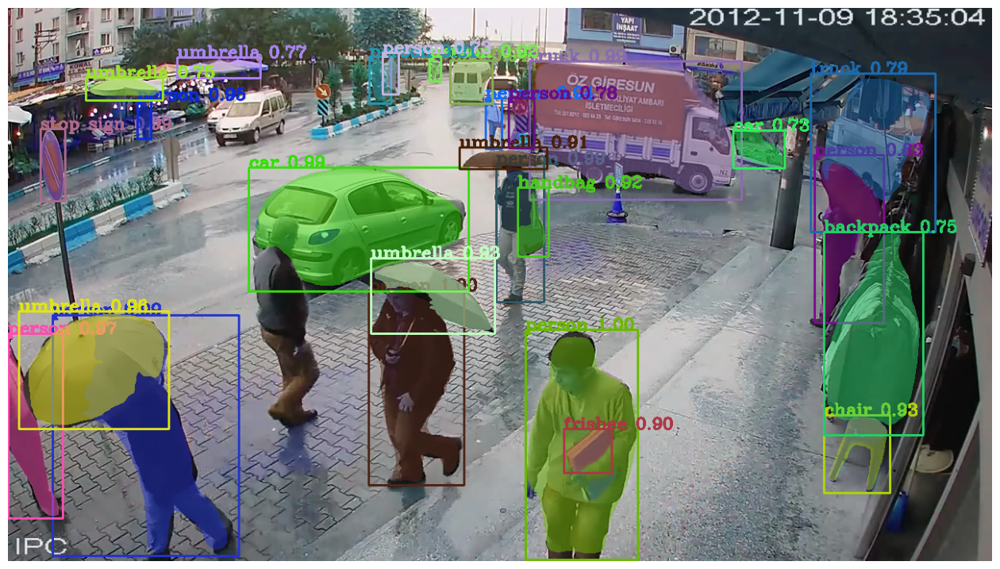

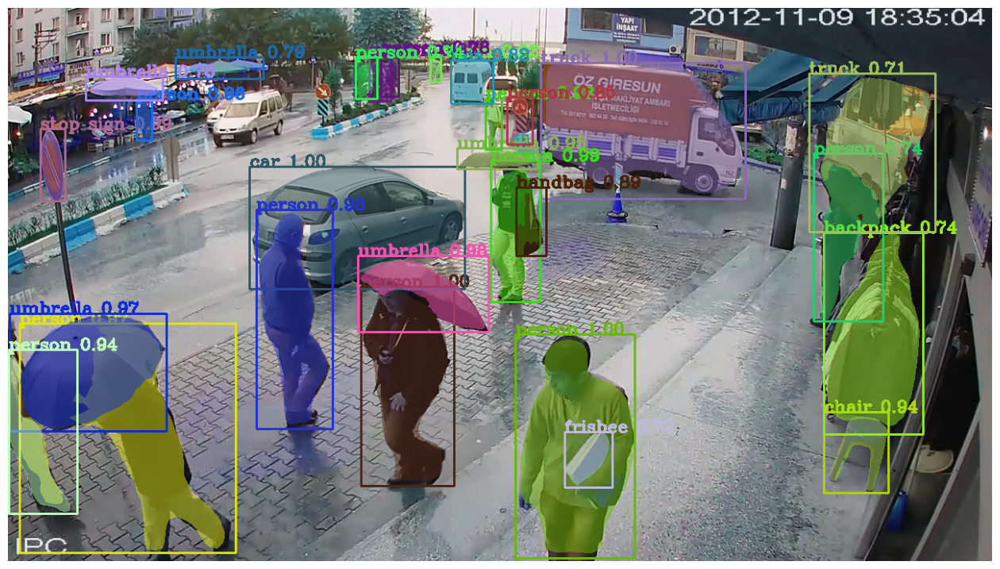

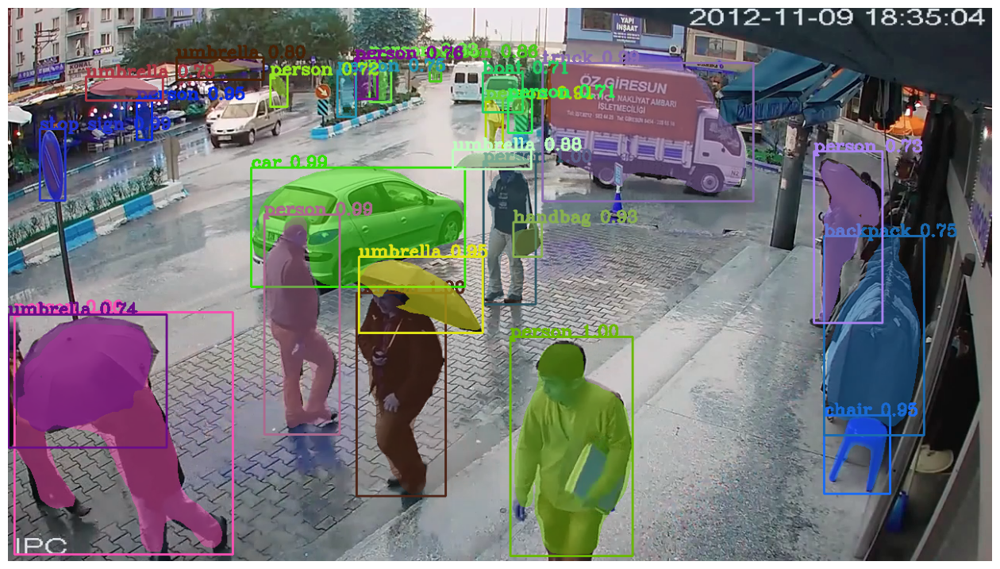

...

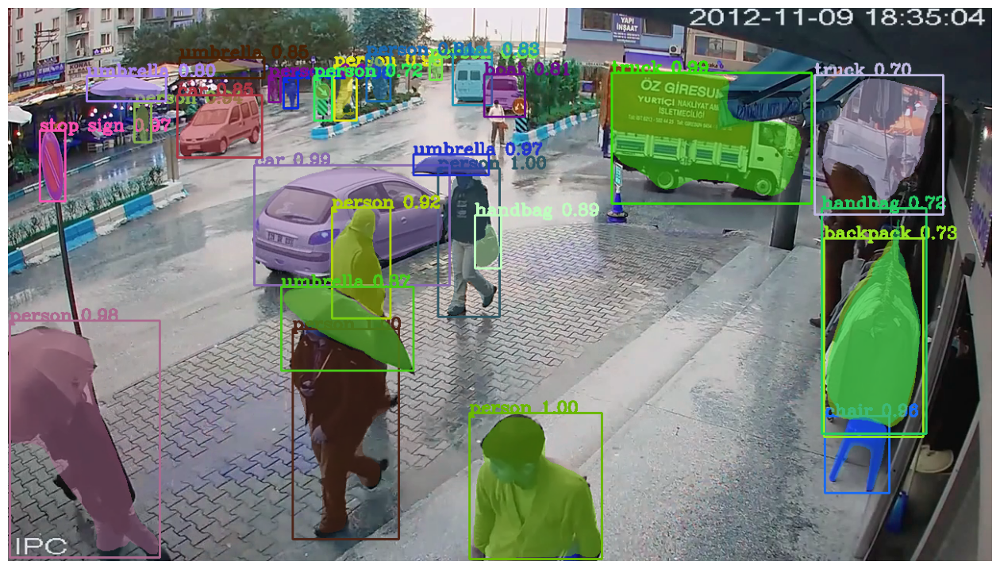

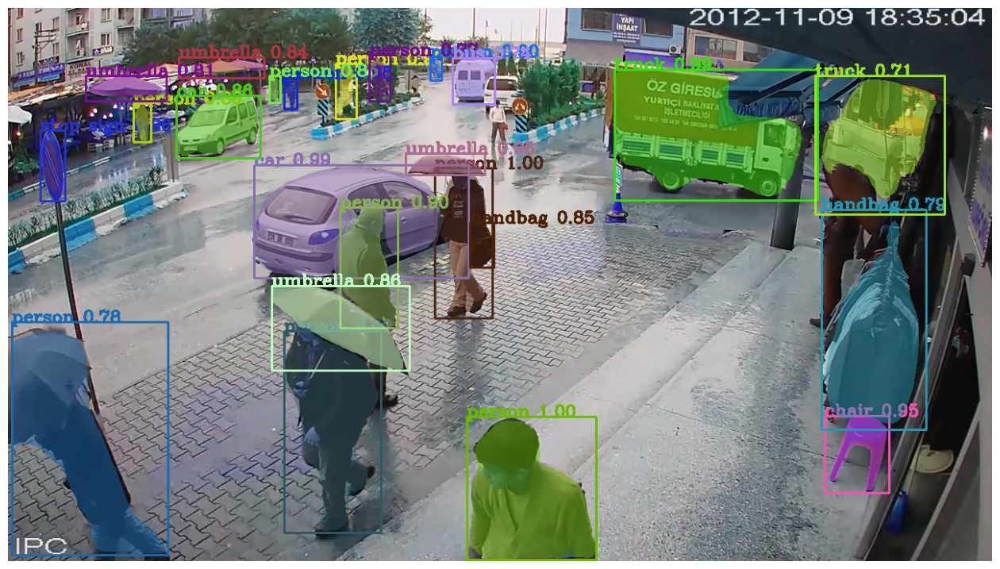

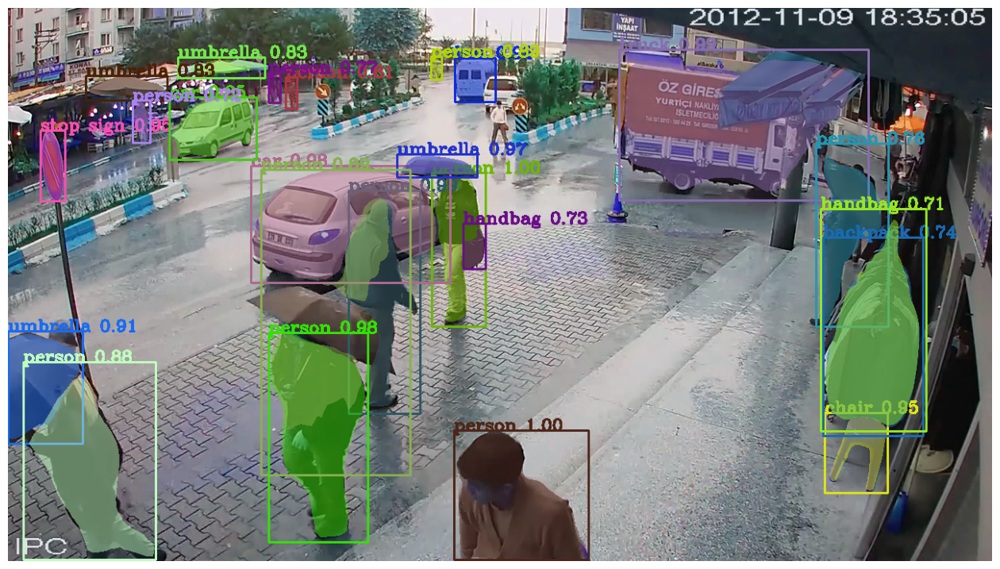

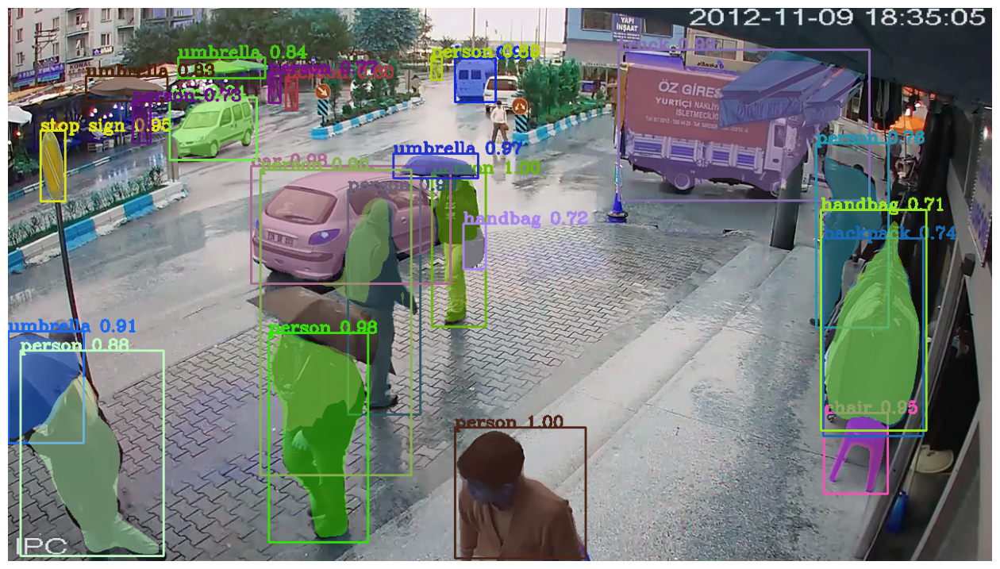

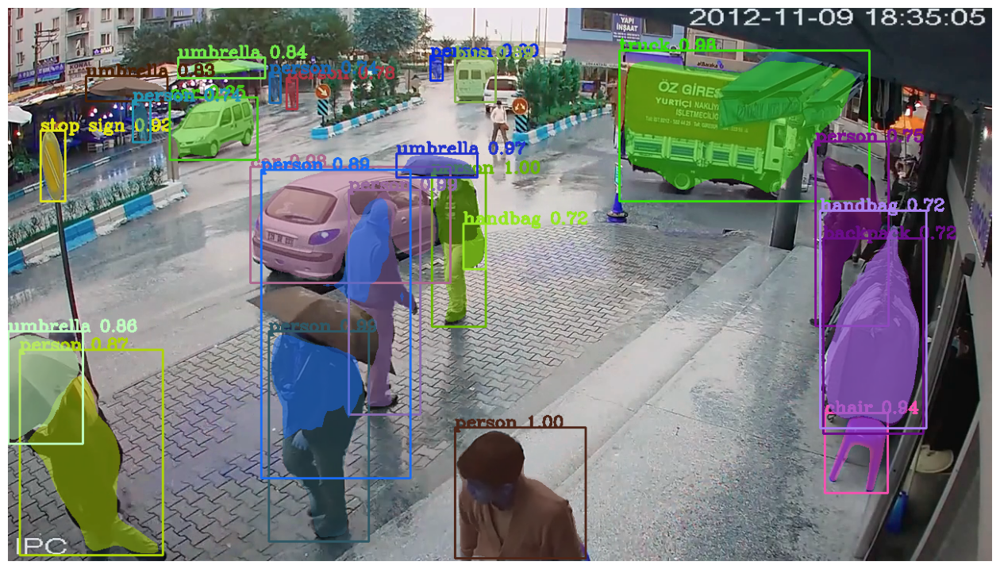

In [ ]:
while (cv2.waitKey(1) < 0):
  connected, frame = capture.read()

  if not connected:
    break

  results = network.detect([frame], verbose=0)
  r = results[0]

  # def display_instances(image, boxes, masks, ids, names, scores)
  processed_frame = visualize_cv.display_instances(frame, r['rois'], r['masks'],
                                                      r['class_ids'], class_names, r['scores'])

  if current_frame <= frame_show:
    show(processed_frame)
    current_frame += 1

  save_video.write(cv2.cvtColor(processed_frame, cv2.COLOR_BGR2RGB))
save_video.release()